In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [3]:
lena = cv2.imread('lena.tif')
caman = cv2.imread('caman.tif')
baboon = cv2.imread('baboon.bmp')

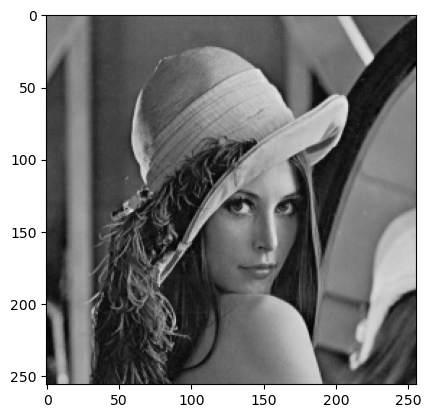

In [4]:
plt.imshow(lena)
plt.show()

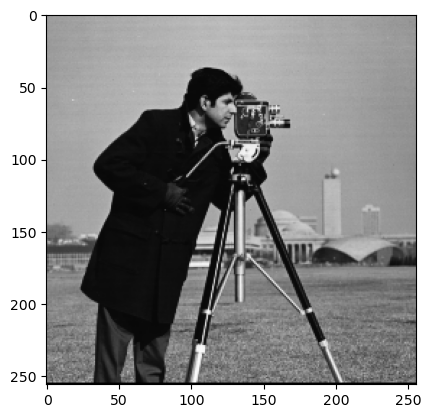

In [5]:
plt.imshow(caman)
plt.show()

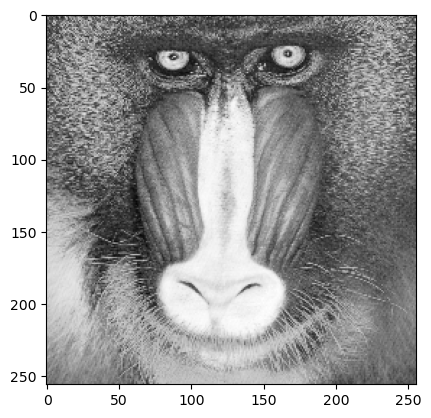

In [6]:
plt.imshow(baboon)
plt.show()

In [18]:
noises = [10, 20, 30, 40]
img_list = ['lena.tif', 'caman.tif', 'baboon.bmp']
filter_sizes = [3, 5, 7]
mse_list = {}

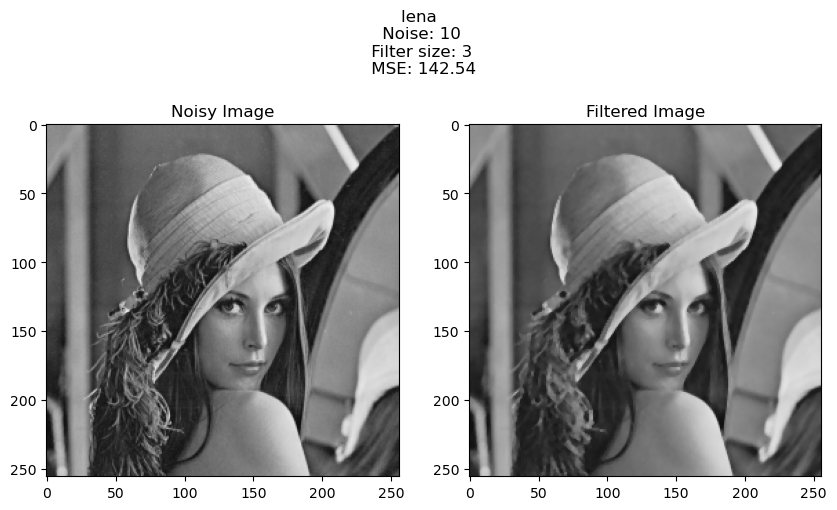

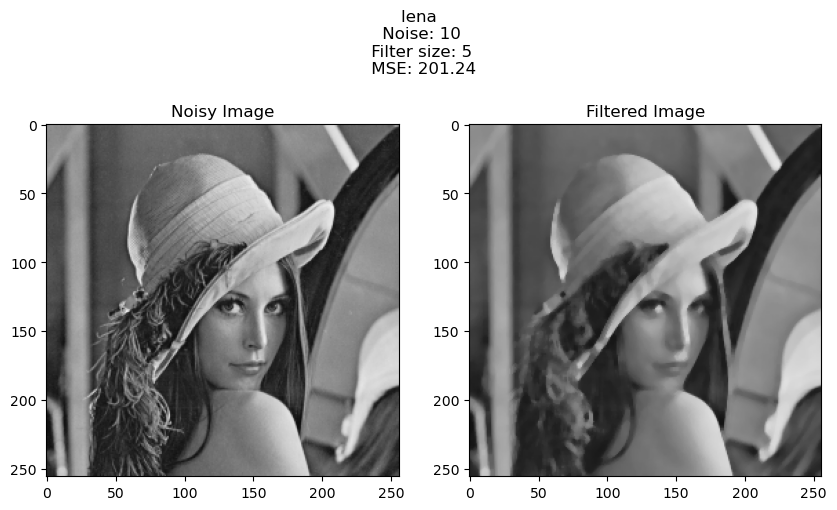

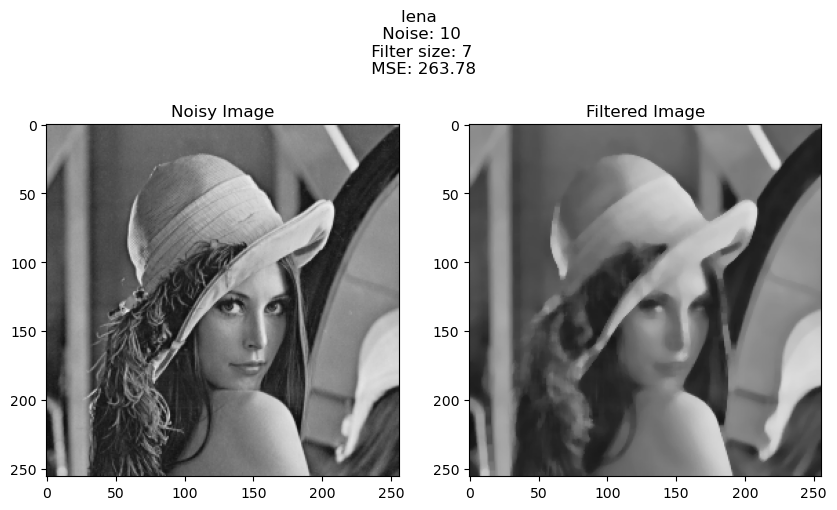

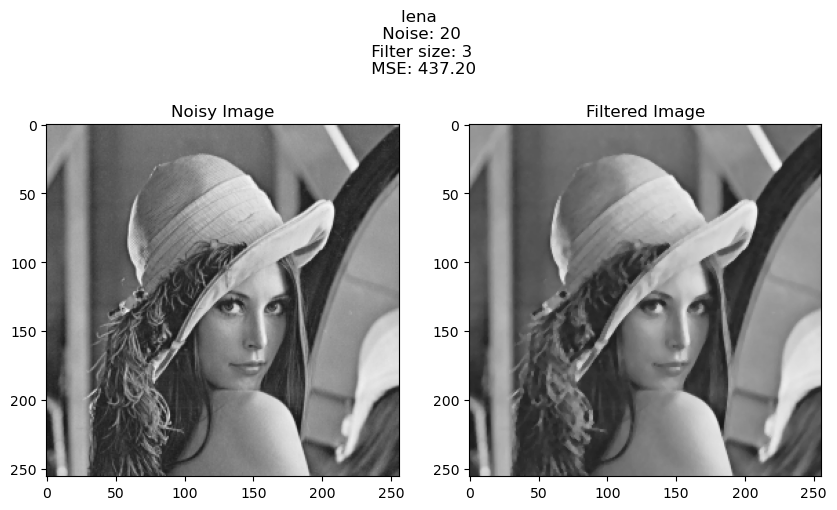

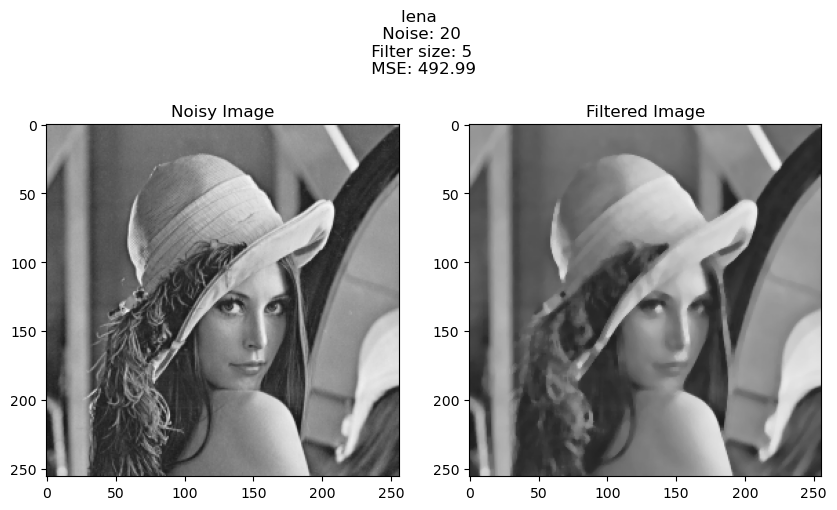

...

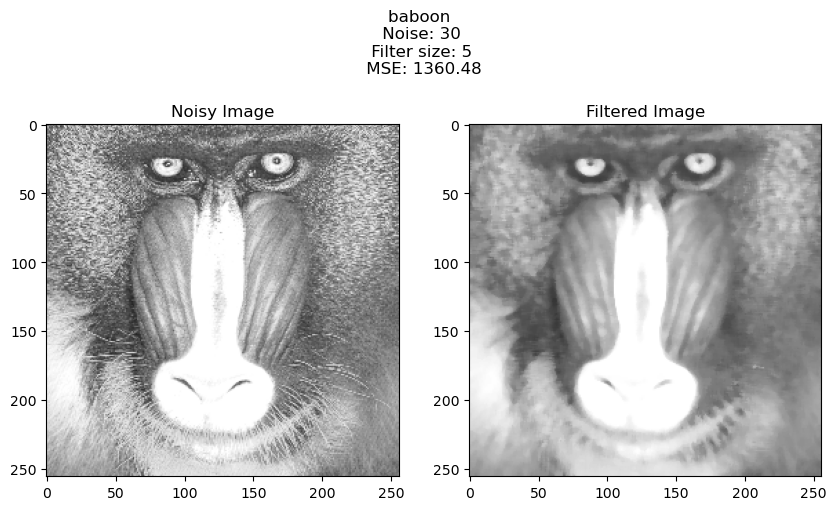

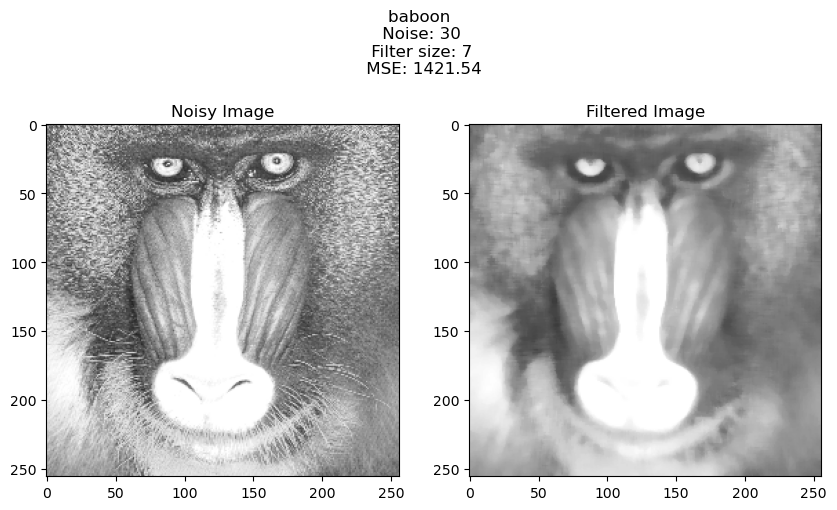

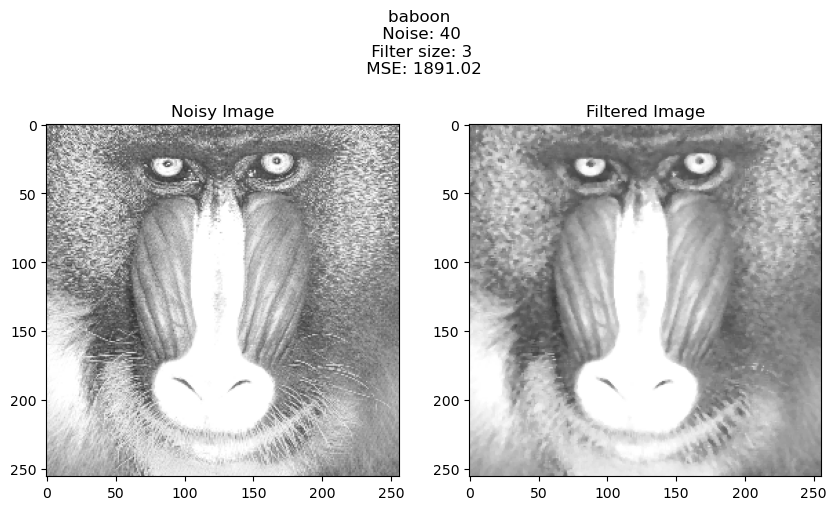

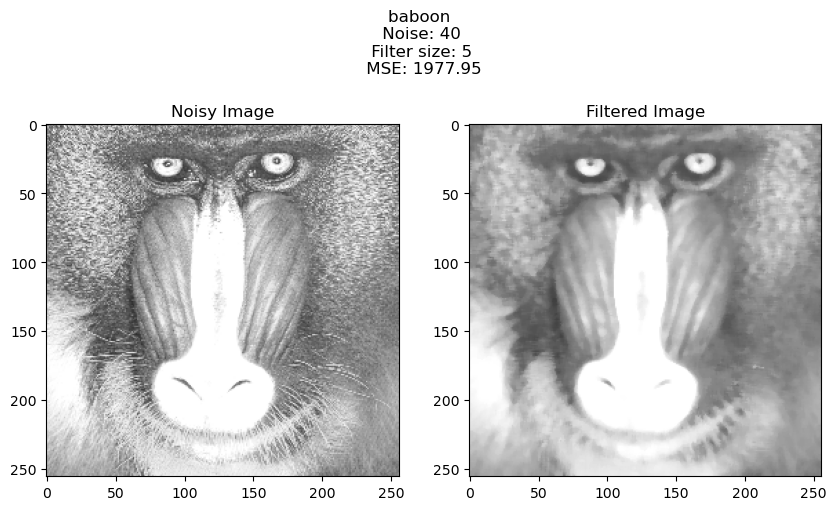

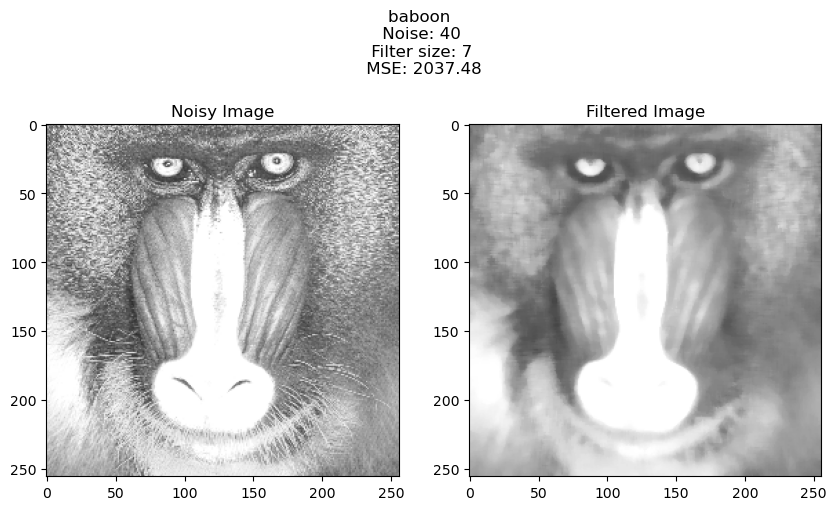

In [21]:
for image in img_list:
    for noise in noises:
        img = cv2.imread(image)
        noise_vector = np.zeros(img.shape, np.int16)
        cv2.randn(noise_vector, 0, noise)
        noisy_img = img.astype(np.int16) + noise
        noisy_img = np.clip(noisy_img, 0, 255).astype(np.uint8)

        for filter_size in filter_sizes:
            filtered_img = cv2.medianBlur(noisy_img, filter_size)
            error = img.astype(np.int16) - filtered_img.astype(np.int16)
            mse = np.mean(np.square(error))
            mse_list.setdefault((image[:-4], noise), {})[filter_size] = mse

            fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 6))
            ax1.imshow(noisy_img, cmap='gray')
            ax1.set_title('Noisy Image')
            ax2.imshow(filtered_img, cmap='gray')
            ax2.set_title('Filtered Image')
            fig.suptitle(f"{image[:-4]} \n Noise: {noise} \n Filter size: {filter_size} \n MSE: {mse:.2f}")
            plt.show()


lena - Noise: 10, Best Filter Size: 3, MSE: 142.54
lena - Noise: 20, Best Filter Size: 3, MSE: 437.20
lena - Noise: 30, Best Filter Size: 3, MSE: 931.86
lena - Noise: 40, Best Filter Size: 3, MSE: 1625.85
caman - Noise: 10, Best Filter Size: 3, MSE: 209.17
caman - Noise: 20, Best Filter Size: 3, MSE: 501.03
caman - Noise: 30, Best Filter Size: 3, MSE: 991.02
caman - Noise: 40, Best Filter Size: 3, MSE: 1677.44
baboon - Noise: 10, Best Filter Size: 3, MSE: 552.14
baboon - Noise: 20, Best Filter Size: 3, MSE: 827.66
baboon - Noise: 30, Best Filter Size: 3, MSE: 1275.48
baboon - Noise: 40, Best Filter Size: 3, MSE: 1891.02
------------------------------------------------
Filter Size: 3 
Count: 12
Filter Size: 5 
Count: 0
Filter Size: 7 
Count: 0


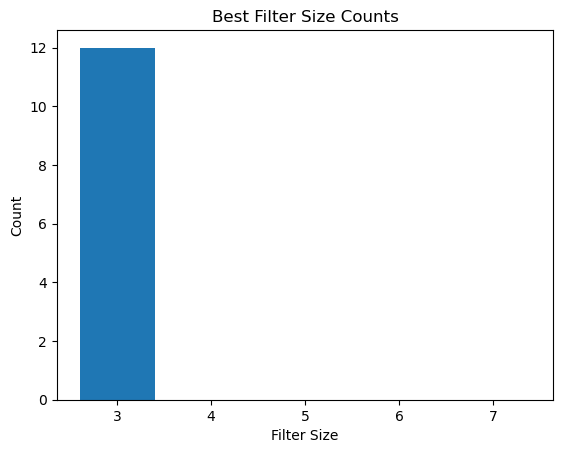

In [27]:
best_filter_sizes = []

for key in mse_list:
    best_filter_size = min(mse_list[key], key=mse_list[key].get)    
    best_filter_sizes.append(best_filter_size)
    
    print(f"{key[0]} - Noise: {key[1]}, Best Filter Size: {best_filter_size}, MSE: {mse_list[key][best_filter_size]:.2f}")
    
best_filter_count = {}

print('------------------------------------------------')

for filter_size in filter_sizes:
    count = best_filter_sizes.count(filter_size)
    
    best_filter_count[filter_size] = count
    
    print(f"Filter Size: {filter_size} \nCount: {count}")
    
plt.bar(best_filter_count.keys(), best_filter_count.values())
plt.xlabel('Filter Size')
plt.ylabel('Count')
plt.title('Best Filter Size Counts')
plt.show()

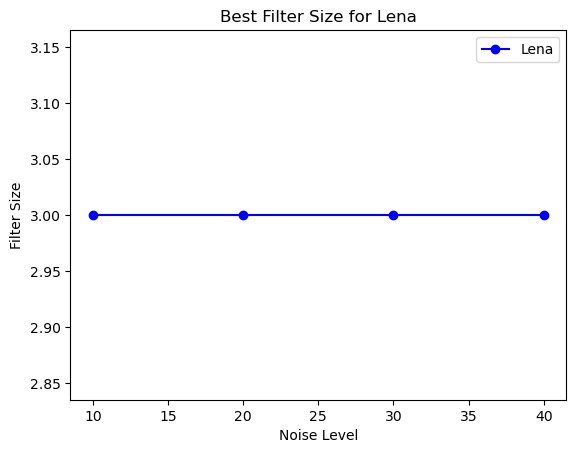

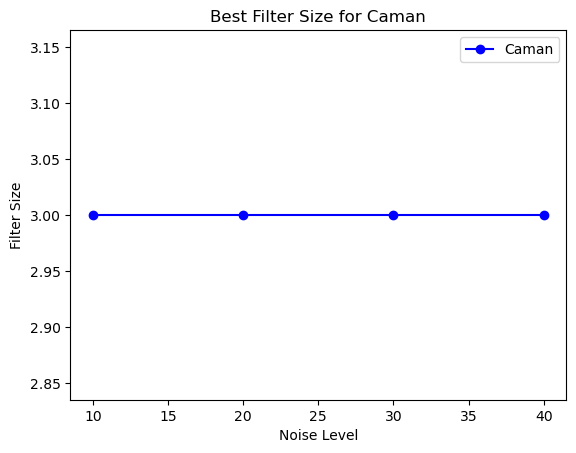

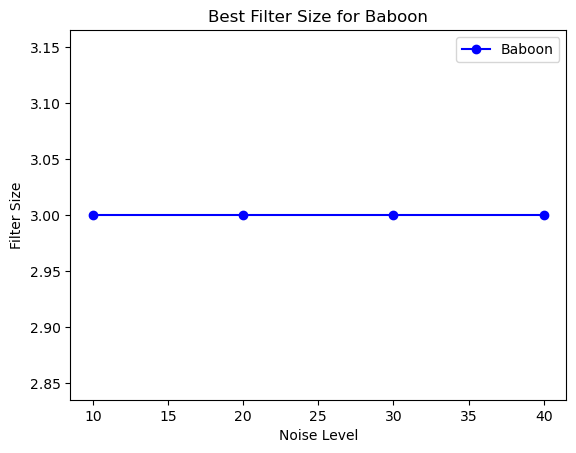

In [28]:
best_filter_sizes_dict = {}

for key in mse_list:
    best_filter_size = min(mse_list[key], key=mse_list[key].get)
    best_filter_sizes_dict.setdefault(key[0], {})[key[1]] = best_filter_size

for image in img_list:
    image = image[:-4]
    x_values = []
    y_values = []
    
    for noise in noises:
        best_filter_size = best_filter_sizes_dict[image][noise]
        
        x_values.append(noise)
        y_values.append(best_filter_size)
    
    plt.figure()
    plt.plot(x_values, y_values, label=image.title(), color='blue', marker='o')
    plt.legend()
    plt.title(f'Best Filter Size for {image.title()}')
    plt.xlabel('Noise Level')
    plt.ylabel('Filter Size')

plt.show()


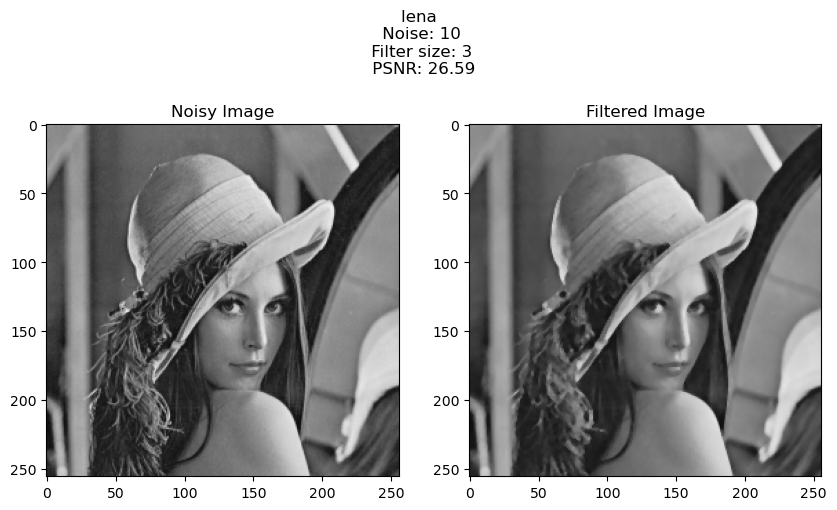

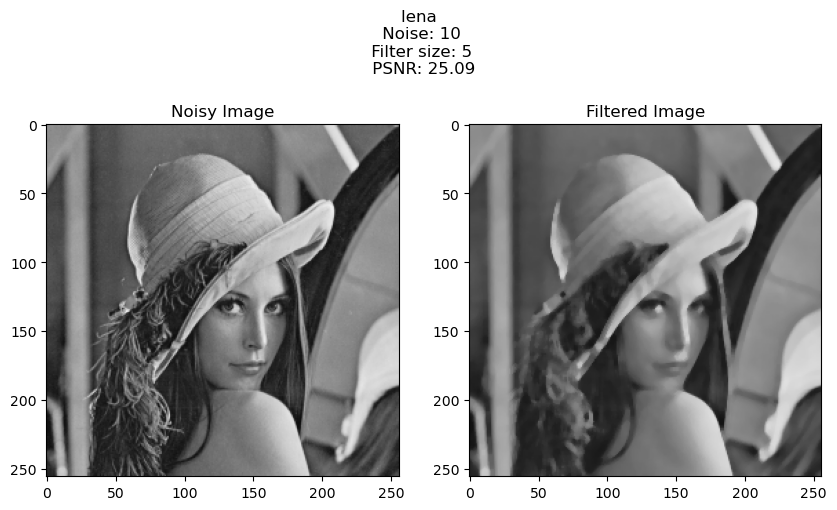

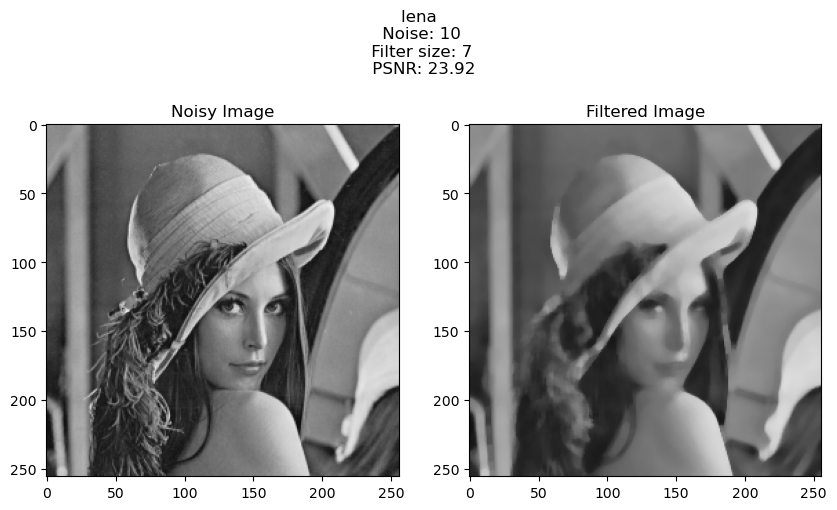

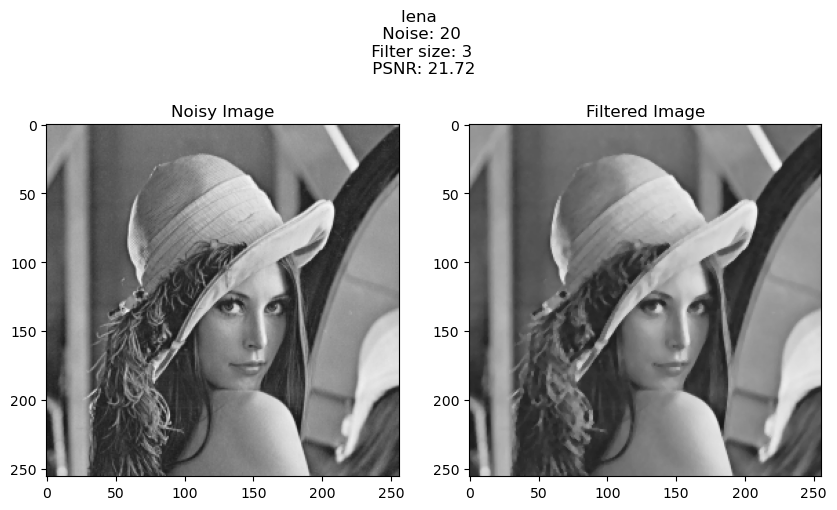

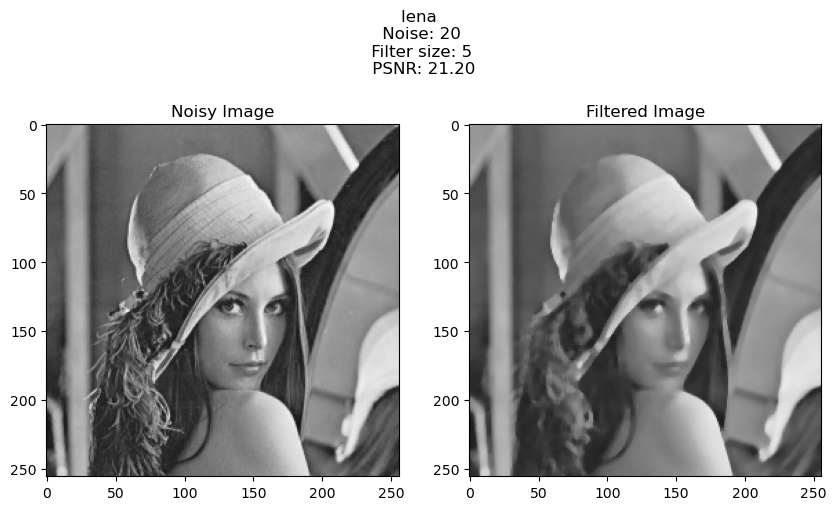

...

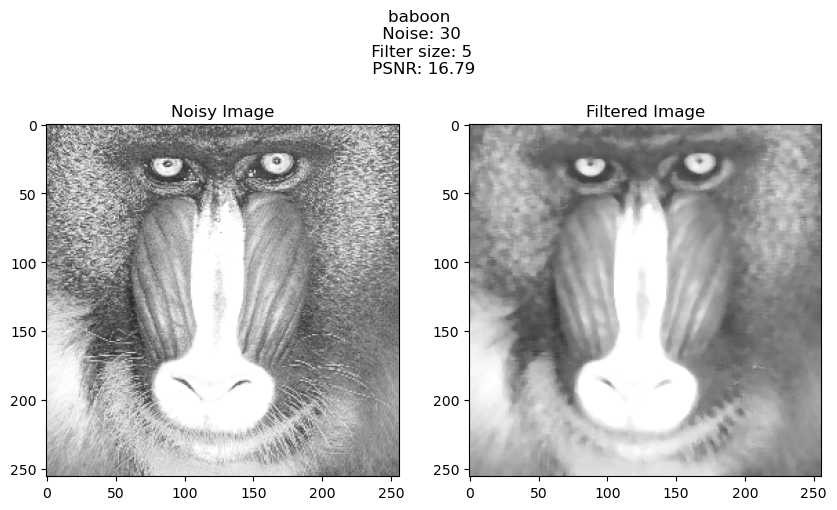

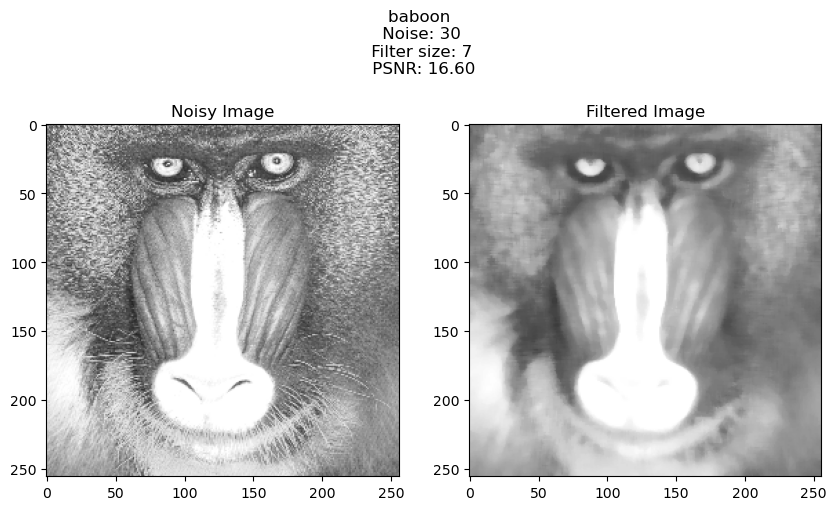

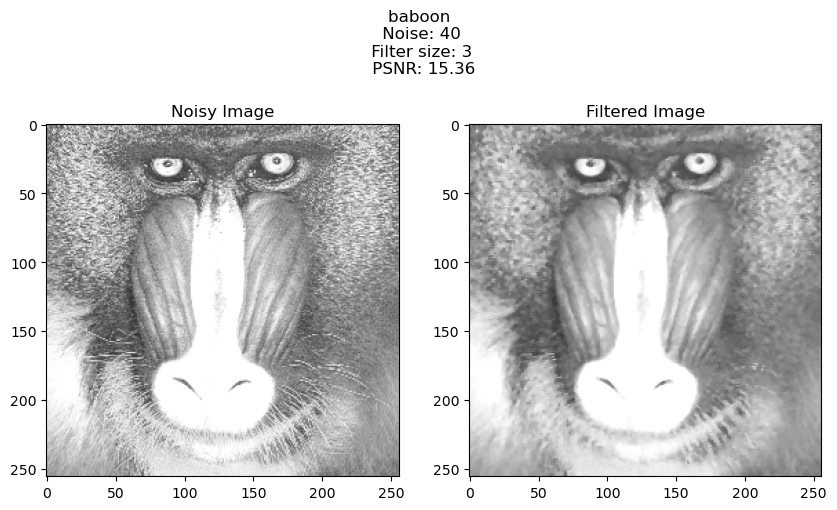

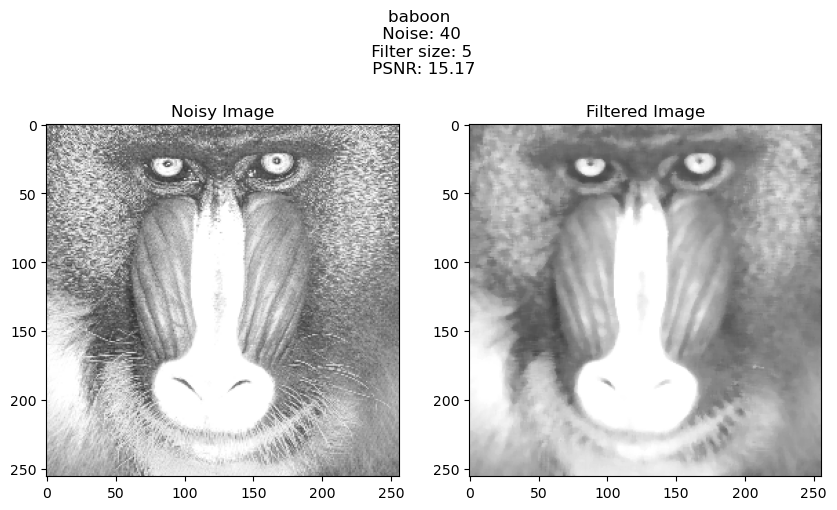

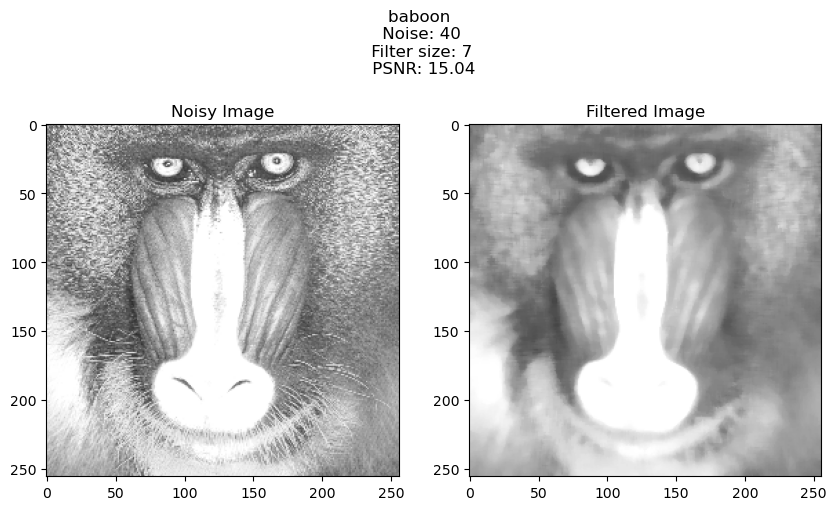

In [31]:
psnr_values = {}

for image in img_list:
    for noise in noises:
        img = cv2.imread(image)
        noise_vector = np.zeros(img.shape, np.int16)
        cv2.randn(noise_vector, 0, noise)
        noisy_img = img.astype(np.int16) + noise
        noisy_img = np.clip(noisy_img, 0, 255).astype(np.uint8)
        
        for filter_size in filter_sizes:
            
            filtered_img = cv2.medianBlur(noisy_img, filter_size)
            error = img.astype(np.int16) - filtered_img.astype(np.int16)
            mse = np.mean(np.square(error))
            psnr = 10 * np.log10(255**2 / mse)
            
            psnr_values.setdefault((image[:-4], noise), {})[filter_size] = psnr
            
            fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 6))
            ax1.imshow(noisy_img, cmap='gray')
            ax1.set_title('Noisy Image')
            ax2.imshow(filtered_img, cmap='gray')
            ax2.set_title('Filtered Image')
            fig.suptitle(f"{image[:-4]} \n Noise: {noise} \n Filter size: {filter_size} \n PSNR: {psnr:.2f}")
            plt.show()
